In [2]:
#import the libraries
import psycopg2
import geopandas as gpd
from shapely.geometry import Point, Polygon
#import contextily as cx
#import osmnx as ox
import shapely

import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor

from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD

c:\Users\jesic\anaconda3\envs\osm2\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.0
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [3]:
# PostgreSQL database connection details
db_params = {
    "host": "::1",
    "database": "osm",
    "user": "postgres",
    "password": 
}

In [4]:
#define the query
conn = psycopg2.connect(**db_params)
query_table1 = """
    select * from planet_osm_point  
"""

In [5]:
#define the query
conn = psycopg2.connect(**db_params)
query_table2 = """
    select * from planet_osm_polygon
"""

In [6]:
#define the query
conn = psycopg2.connect(**db_params)
query_table3 = """
    select * from planet_osm_roads
"""

In [7]:
#generate the table from the query
gdf_table1 = gpd.read_postgis(query_table1, conn, geom_col="way")
#observe the dataset
gdf_table1.head()

c:\Users\jesic\anaconda3\envs\osm2\lib\site-packages\geopandas\io\sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,osm_id,access,addr:housename,addr:housenumber,addr:interpolation,admin_level,aerialway,aeroway,amenity,area,...,tourism,tower:type,tunnel,water,waterway,wetland,width,wood,z_order,way
0,10218562211,None,None,None,None,None,None,None,waste_basket,None,...,None,None,None,None,None,None,None,None,None,POINT (1498270.511 6894249.567)
1,9937482583,yes,None,None,None,None,None,None,bicycle_parking,None,...,None,None,None,None,None,None,None,None,None,POINT (1498268.341 6894242.963)
2,10218567031,yes,None,None,None,None,None,None,bicycle_parking,None,...,None,None,None,None,None,None,None,None,None,POINT (1498274.797 6894236.487)
3,8251684062,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (1498285.740 6894239.267)
4,8251684061,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,POINT (1498290.716 6894237.164)


In [8]:
#generate the table from the query
gdf_table2 = gpd.read_postgis(query_table2, conn, geom_col="way")
#observe the dataset
gdf_table2.head()

c:\Users\jesic\anaconda3\envs\osm2\lib\site-packages\geopandas\io\sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,osm_id,access,addr:housename,addr:housenumber,addr:interpolation,admin_level,aerialway,aeroway,amenity,area,...,tracktype,tunnel,water,waterway,wetland,width,wood,z_order,way_area,way
0,959689475,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,0,340855.00,"POLYGON ((1506976.408 6907843.966, 1507293.368..."
1,959689479,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,0,812145.00,"POLYGON ((1508094.033 6908067.858, 1508104.074..."
2,878232524,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,0,3444.40,"POLYGON ((1508672.895 6907508.671, 1508709.374..."
3,959689477,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,0,729680.00,"POLYGON ((1508350.012 6906897.762, 1508417.194..."
4,457926227,None,None,None,None,None,None,None,None,None,...,None,None,pond,None,None,None,None,0,1080.43,"POLYGON ((1508910.684 6906909.709, 1508913.144..."


In [9]:
#generate the table from the query
gdf_table3 = gpd.read_postgis(query_table3, conn, geom_col="way")
#observe the dataset
gdf_table3.head()

c:\Users\jesic\anaconda3\envs\osm2\lib\site-packages\geopandas\io\sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,osm_id,access,addr:housename,addr:housenumber,addr:interpolation,admin_level,aerialway,aeroway,amenity,area,...,tracktype,tunnel,water,waterway,wetland,width,wood,z_order,way_area,way
0,267232461,None,None,None,None,9,None,None,None,None,...,None,None,None,None,None,None,None,0,None,"LINESTRING (1505311.180 6916823.578, 1505734.3..."
1,89253562,None,None,None,None,9,None,None,None,None,...,None,None,None,None,None,None,None,0,None,"LINESTRING (1508323.697 6906913.959, 1508739.2..."
2,50336558,None,None,None,None,4,None,None,None,None,...,None,None,None,None,None,None,None,0,None,"LINESTRING (1508323.697 6906913.959, 1508301.8..."
3,-1318349,None,None,None,None,8,None,None,None,None,...,None,None,None,None,None,None,None,0,None,"LINESTRING (1509996.049 6910435.194, 1509976.5..."
4,5052078,None,None,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,35,None,"LINESTRING (1510332.657 6904601.036, 1510392.0..."


In [10]:
gdf_table3.to_csv("roads.csv")

In [11]:
conn.close ()

In [21]:
#observe the properties of the table
gdf_table1.count().sort_values(ascending=False)[0:30]

osm_id              905937
way                 905937
addr:housenumber    331523
natural             219639
highway             117867
amenity              94306
barrier              79645
name                 70929
access               31886
operator             25837
ref                  23668
railway              20798
covered              18729
shop                 18436
man_made             14428
public_transport     10949
tourism               7576
brand                 6948
bicycle               6411
foot                  5435
leisure               4311
office                4301
power                 3448
historic              3172
sport                 2507
ele                   2284
layer                 1607
tower:type            1107
surface                918
motorcar               802
dtype: int64

In [8]:
#we look at the main amenities
gdf_table1.amenity.value_counts()[0:50]

bench               25245
bicycle_parking     17260
waste_basket        14810
restaurant           4348
recycling            2582
post_box             2462
vending_machine      2393
cafe                 2294
fast_food            2252
parking_entrance     1908
doctors              1293
kindergarten         1225
atm                  1013
pub                   957
bar                   868
charging_station      815
telephone             738
pharmacy              707
dentist               700
clock                 560
parcel_locker         559
toilets               542
social_facility       532
parking               530
bicycle_rental        515
waste_disposal        403
taxi                  360
fountain              359
community_centre      351
bank                  323
ice_cream             297
hunting_stand         283
shelter               233
driving_school        232
drinking_water        223
post_office           189
place_of_worship      184
grit_bin              169
veterinary  

In [9]:
gdf_table1.railway.value_counts()[0:50]

signal                               4857
switch                               3956
tram_crossing                        2859
tram_level_crossing                  1901
milestone                            1646
tram_stop                             913
power_supply                          862
stop                                  829
subway_entrance                       652
buffer_stop                           615
level_crossing                        466
crossing                              338
railway_crossing                      319
station                               282
halt                                   68
derail                                 39
junction                               36
site                                   27
radio                                  20
phone                                  18
train_station_entrance                 16
yard                                   14
service_station                        10
defect_detector                   

In [22]:
gdf_table1.shop.value_counts()[0:50]

hairdresser            1857
clothes                1518
bakery                 1281
convenience             950
supermarket             891
beauty                  865
florist                 594
kiosk                   537
bicycle                 378
optician                345
car_repair              340
jewelry                 331
mobile_phone            309
books                   306
massage                 294
travel_agency           267
shoes                   262
chemist                 232
furniture               227
vacant                  217
tailor                  209
deli                    197
interior_decoration     182
car                     164
beverages               159
stationery              159
variety_store           153
funeral_directors       144
medical_supply          136
cosmetics               136
electronics             135
laundry                 132
dry_cleaning            131
art                     129
gift                    126
butcher             

In [24]:
gdf_table1.public_transport.value_counts()

stop_position            8209
platform                 1969
station                   424
entrance                  137
destination_display        75
info_board                 73
platform_section_sign      51
stop_area                   4
timetable                   3
validator                   2
ticket_office               1
stop                        1
Name: public_transport, dtype: int64

In [25]:
#observe the properties of the table
gdf_table2.count().sort_values(ascending=False)[0:30]

osm_id              631785
z_order             631785
way_area            631785
way                 631785
building            526185
addr:housenumber    110462
amenity              37004
landuse              36053
access               26409
name                 22237
leisure              15909
surface              13391
natural              12238
operator              6069
layer                 5464
man_made              5257
sport                 4823
area                  4027
covered               3649
power                 2428
barrier               2167
ref                   2060
shop                  1966
generator:source      1552
brand                 1469
addr:housename        1393
highway               1063
water                  971
public_transport       939
religion               939
dtype: int64

In [26]:
gdf_table2.building.value_counts()[0:50]

yes                   268733
apartments             71225
house                  31696
detached               24202
residential            20813
shed                   20390
garage                 18948
terrace                11987
allotment_house        10830
semidetached_house      6525
commercial              4840
bungalow                4480
roof                    4182
garages                 3605
industrial              2781
retail                  2573
school                  2207
hut                     2108
office                  2074
service                 2014
carport                  885
kindergarten             874
construction             718
hospital                 668
church                   484
university               457
warehouse                409
civic                    385
hotel                    374
greenhouse               321
dormitory                254
train_station            235
government               230
sports_centre            212
sports_hall   

In [26]:
gdf_table2.access.value_counts()[0:50]

yes                      12229
private                  10077
customers                 2264
permissive                 813
no                         541
destination                305
permit                     119
employees                   37
residents                    5
delivery                     4
disabled                     3
unknown                      2
forestry                     2
members                      1
tourist_bus                  1
green_sticker_germany        1
car_sharing                  1
limited                      1
key                          1
öffentliche_toilette         1
construction                 1
Name: access, dtype: int64

In [27]:
#observe the properties of the table
gdf_table3.count().sort_values(ascending=False)[0:30]

osm_id              31677
z_order             31677
way                 31677
name                17896
highway             16635
surface             16243
railway             13910
oneway              13013
operator             8986
ref                  8517
foot                 7496
service              4849
layer                4238
bicycle              3861
bridge               2373
tunnel               1318
boundary             1262
admin_level          1262
width                 814
historic              795
public_transport      729
embankment            423
access                156
construction          144
place                 122
covered               105
junction              105
disused                96
horse                  78
cutting                69
dtype: int64

In [29]:
gdf_table3.highway.value_counts()

secondary         10741
primary            4006
motorway            687
motorway_link       629
secondary_link      227
primary_link        131
trunk                68
footway              49
service              46
trunk_link           16
platform             11
residential           9
path                  6
steps                 4
track                 2
cycleway              2
pedestrian            1
Name: highway, dtype: int64

In [265]:
#we filter the food amenities:
food = gdf_table1[gdf_table1.amenity.isin(['restaurant', 'cafe','fast_food', 'pub','bar'])]
food.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 10719 entries, 210 to 905836
Data columns (total 70 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   osm_id              10719 non-null  int64   
 1   access              24 non-null     object  
 2   addr:housename      54 non-null     object  
 3   addr:housenumber    7498 non-null   object  
 4   addr:interpolation  0 non-null      object  
 5   admin_level         0 non-null      object  
 6   aerialway           0 non-null      object  
 7   aeroway             0 non-null      object  
 8   amenity             10719 non-null  object  
 9   area                0 non-null      object  
 10  barrier             0 non-null      object  
 11  bicycle             0 non-null      object  
 12  brand               351 non-null    object  
 13  bridge              0 non-null      object  
 14  boundary            0 non-null      object  
 15  building            2 non

In [266]:
#we filter the food dataset
food = food[["name", "way"]]
food.head()

,name,way
210,Aladdin's Döner,POINT (1502796.227 6904067.605)
229,Dolce Vita,POINT (1502815.007 6904057.605)
327,Gaststätte Barnimquell,POINT (1502761.941 6903297.825)
381,Mandy,POINT (1502403.659 6903793.952)
670,Pizzafabrik.de,POINT (1503203.991 6903091.629)


In [267]:
#Convert polygons to points
food['way'] = food['way'].apply(lambda x : x.centroid if type(x) == Polygon else x)

In [268]:
#Simplifying the df and converting crs in case of plotting on other map tiles
food = food.to_crs(epsg=3857)
food.explore()

In [269]:
food['way'] = food.buffer(400)
food.explore(style_kwds={'stroke':False, 'fillOpacity':0.05})

In [270]:
food.head()

,name,way
210,Aladdin's Döner,"POLYGON ((1503196.227 6904067.605, 1503194.301..."
229,Dolce Vita,"POLYGON ((1503215.007 6904057.605, 1503213.081..."
327,Gaststätte Barnimquell,"POLYGON ((1503161.941 6903297.825, 1503160.015..."
381,Mandy,"POLYGON ((1502803.659 6903793.952, 1502801.733..."
670,Pizzafabrik.de,"POLYGON ((1503603.991 6903091.629, 1503602.065..."


In [275]:
#define the query
conn = psycopg2.connect(**db_params)
query_table2 = """
    select * from amenity_counts  
"""

In [276]:
#generate the table from the query
amenity_count = gpd.read_postgis(query_table2, conn, geom_col="point_id")
#observe the dataset
amenity_count.head()
conn.close()

c:\Users\jesic\anaconda3\envs\osm2\lib\site-packages\geopandas\io\sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [277]:
amenity_count.columns

Index(['point_id', 'amenity_count_restaurant', 'amenity_count_cafe',
       'amenity_count_fast_food', 'amenity_count_pub', 'amenity_count_bar',
       'amenity_count_bicycle_parking', 'amenity_count_parking_entrance',
       'amenity_count_atm', 'amenity_count_charging_station',
       'amenity_count_pharmacy', 'amenity_count_parking', 'amenity_count_taxi',
       'amenity_count_bank', 'amenity_count_ice_cream',
       'amenity_count_post_office', 'amenity_count_place_of_worship',
       'amenity_count_fuel', 'amenity_count_theatre',
       'amenity_count_nightclub', 'amenity_count_school',
       'amenity_count_library', 'amenity_count_events_venue',
       'amenity_count_arts_centre', 'amenity_count_car_rental',
       'amenity_count_marketplace', 'amenity_count_cinema',
       'amenity_count_ticket_validator', 'amenity_count_childcare',
       'amenity_count_public_bookcase', 'amenity_count_studio',
       'railway_count_tram_stop', 'railway_count_stop',
       'railway_count_subwa

In [278]:
amenity_count_model=amenity_count.copy()
amenity_count_model["food_and_bev"]=amenity_count['amenity_count_restaurant']+amenity_count['amenity_count_cafe']+amenity_count['amenity_count_fast_food']+amenity_count['amenity_count_pub']+amenity_count['amenity_count_bar']
amenity_count_model = amenity_count_model.drop(columns=[ 'amenity_count_restaurant', 'amenity_count_cafe',
       'amenity_count_fast_food', 'amenity_count_pub', 'amenity_count_bar'])

In [279]:
amenity_count_model.head()

,point_id,amenity_count_bicycle_parking,amenity_count_parking_entrance,amenity_count_atm,amenity_count_charging_station,amenity_count_pharmacy,amenity_count_parking,amenity_count_taxi,amenity_count_bank,amenity_count_ice_cream,...,amenity_count_public_bookcase,amenity_count_studio,railway_count_tram_stop,railway_count_stop,railway_count_subway_entrance,railway_count_buffer_stop,railway_count_crossing,railway_count_station,railway_count_train_station_entrance,food_and_bev
0,POINT (1517540.719 6908029.571),0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,POINT (1517740.719 6908029.571),0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,POINT (1517940.719 6908029.571),0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,POINT (1518140.719 6908029.571),0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,POINT (1518340.719 6908029.571),0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<AxesSubplot:xlabel='food_and_bev', ylabel='Count'>

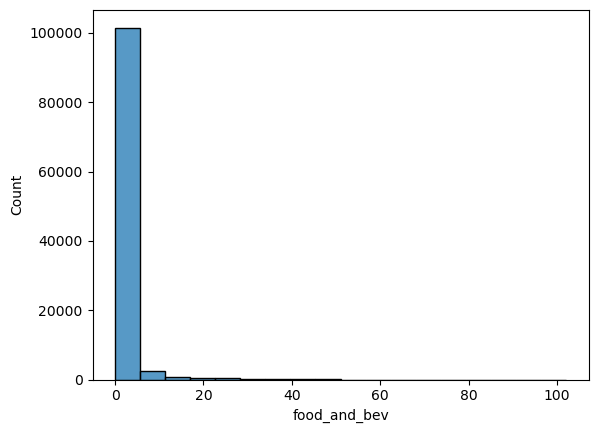

In [280]:
sns.histplot(data=amenity_count_model,x="food_and_bev")

<AxesSubplot:xlabel='food_and_bev', ylabel='Count'>

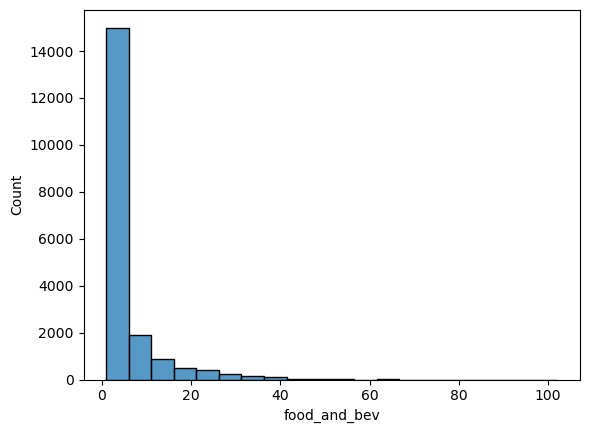

In [281]:
sns.histplot(data=amenity_count_model[amenity_count_model["food_and_bev"]>0],x="food_and_bev", bins=20)

In [282]:
amenity_count_model.describe()

,amenity_count_bicycle_parking,amenity_count_parking_entrance,amenity_count_atm,amenity_count_charging_station,amenity_count_pharmacy,amenity_count_parking,amenity_count_taxi,amenity_count_bank,amenity_count_ice_cream,amenity_count_post_office,...,amenity_count_public_bookcase,amenity_count_studio,railway_count_tram_stop,railway_count_stop,railway_count_subway_entrance,railway_count_buffer_stop,railway_count_crossing,railway_count_station,railway_count_train_station_entrance,food_and_bev
count,106500.000000,106500.000000,106500.000000,106500.000000,106500.00000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,...,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000,106500.000000
mean,3.181146,0.351587,0.186498,0.150423,0.13016,0.097446,0.066150,0.059333,0.055014,0.034995,...,0.012235,0.011869,0.167099,0.152638,0.120075,0.113352,0.062113,0.051878,0.002977,0.947070
std,10.961124,1.330202,0.901801,0.608582,0.48865,0.472303,0.306565,0.380440,0.317720,0.200764,...,0.114616,0.138910,0.762224,0.779414,0.737417,0.798721,0.622448,0.261782,0.075933,3.819856
min,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,167.000000,27.000000,18.000000,14.000000,7.00000,12.000000,8.000000,8.000000,7.000000,4.000000,...,2.000000,6.000000,11.000000,24.000000,17.000000,25.000000,25.000000,5.000000,3.000000,102.000000


In [283]:
amenity_count_model[amenity_count_model["food_and_bev"]>0].describe()

,amenity_count_bicycle_parking,amenity_count_parking_entrance,amenity_count_atm,amenity_count_charging_station,amenity_count_pharmacy,amenity_count_parking,amenity_count_taxi,amenity_count_bank,amenity_count_ice_cream,amenity_count_post_office,...,amenity_count_public_bookcase,amenity_count_studio,railway_count_tram_stop,railway_count_stop,railway_count_subway_entrance,railway_count_buffer_stop,railway_count_crossing,railway_count_station,railway_count_train_station_entrance,food_and_bev
count,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,...,19273.000000,19273.000000,19273.00000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000,19273.000000
mean,13.370622,1.478701,0.979246,0.664038,0.646915,0.397603,0.312769,0.311161,0.284336,0.164531,...,0.044726,0.051627,0.60577,0.731282,0.632180,0.293260,0.172002,0.255487,0.016292,5.233383
std,19.884817,2.485653,1.914227,1.119000,0.955861,0.943070,0.621691,0.838784,0.686927,0.416507,...,0.215313,0.262072,1.41778,1.634951,1.613615,1.270545,1.163627,0.539340,0.177163,7.628885
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,18.000000,2.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.00000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
max,165.000000,25.000000,18.000000,11.000000,7.000000,12.000000,8.000000,8.000000,7.000000,4.000000,...,2.000000,4.000000,10.00000,24.000000,17.000000,25.000000,25.000000,5.000000,3.000000,102.000000
